In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors, cm
from loadmodules import *
import matplotlib.ticker as ticker

In [2]:
k = 1.3807e-16 # boltzmann constant in erg/K (g*cm^2/s^2/K)
solar_mass = 1.989e33 # g
parsec = 3.08567758e18 # cm

In [3]:
simulation_list = [directory for directory in os.listdir('.') if 'Au6_lvl' in directory]
print(simulation_list)

['Au6_lvl5_73b0_k12_1_5evboost', 'Au6_lvl5_73b0_k12_fiducial', 'Au6_lvl4_aa96_cfefit', 'Au6_lvl4_aa96_cfefit_noconstrain', 'Au6_lvl5_aa96_f1_2_shboost', 'Au6_lvl4_aa96_fixcs', 'Au6_lvl5_aa96_fiducial', 'Au6_lvl4_aa96_tightconstrain']


/storage/home/can35/can35007/pylib/gadget_subfind.py:447: H5pyDeprecationWarning: Using astype() as a context manager is deprecated. Slice the returned object instead, like: ds.astype(np.int32)[:10]
  with dset.astype('int64'):
/storage/home/can35/can35007/pylib/gadget_snap.py:730: H5pyDeprecationWarning: Using astype() as a context manager is deprecated. Slice the returned object instead, like: ds.astype(np.int32)[:10]
  with dset.astype('uint64'):


galrad= 0.019405122101306918
Found 73883 stars.


/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/ipykernel_launcher.py:25: RuntimeWarning: divide by zero encountered in log10
/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in log10
/storage/home/can35/can35007/pylib/cosmological_factors.py:100: RuntimeWarning: invalid value encountered in sqrt
  var2 = np.sqrt(self.OmegaLambda / self.OmegaMatter * a**3.0)


Maximum number of formed clusters per star particle:  14


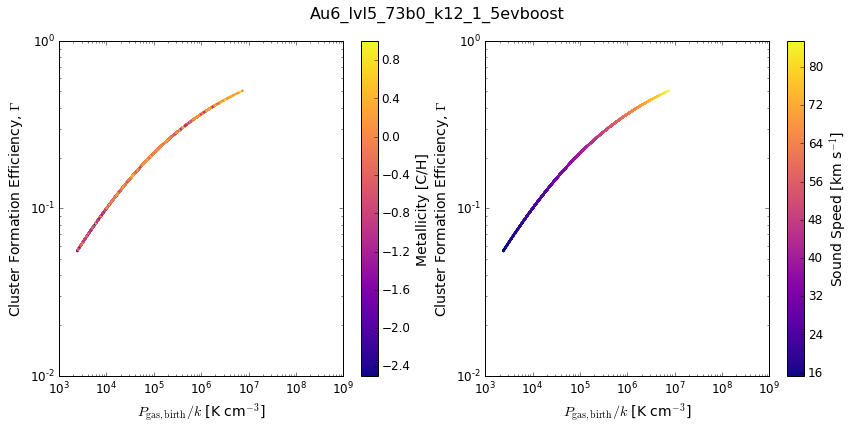

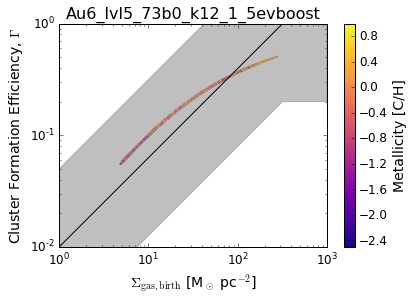

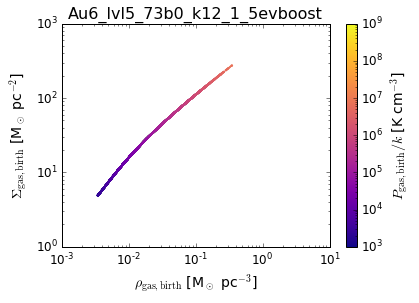

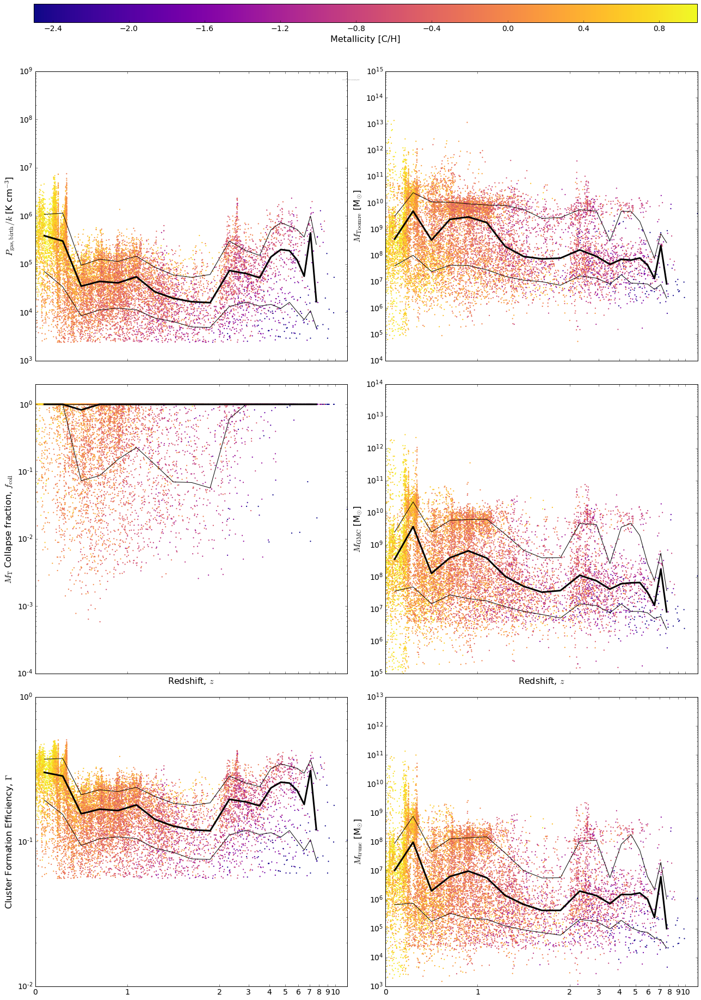

galrad= 0.019405122101306918
Found 73883 stars.
Maximum number of formed clusters per star particle:  14


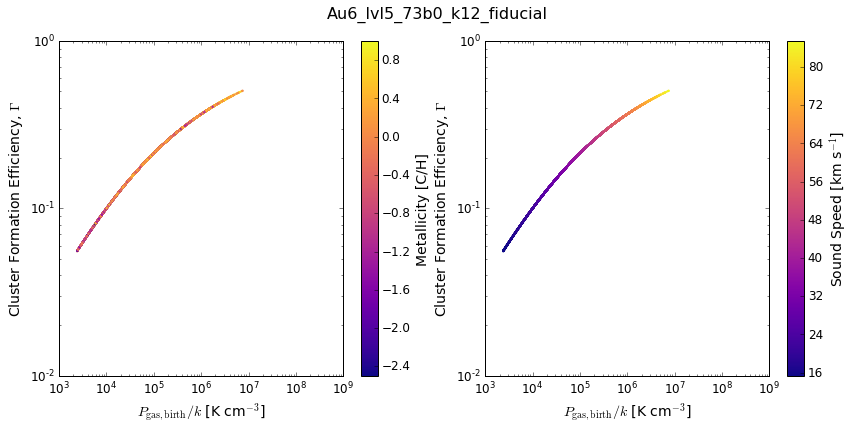

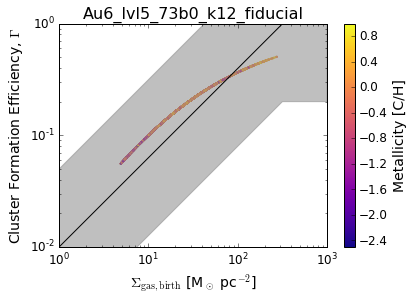

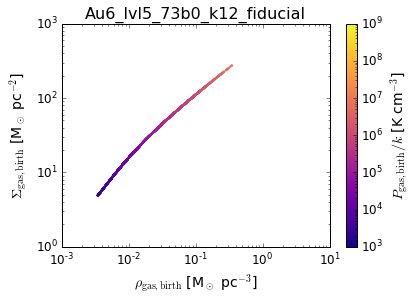

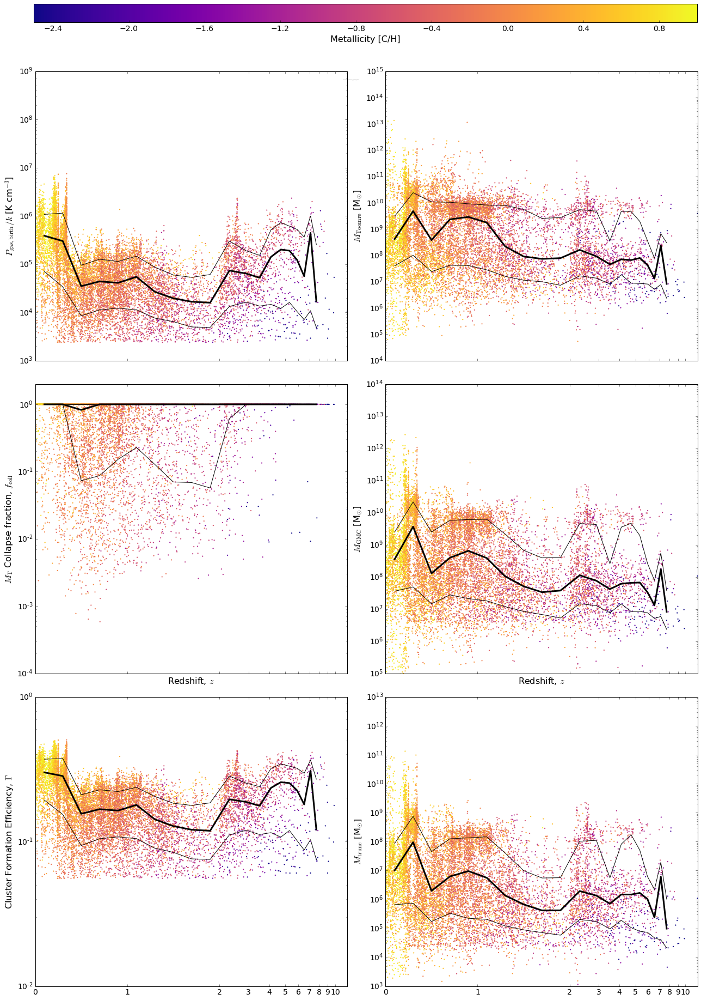

galrad= 0.021321217715740207
Found 1562819 stars.
Maximum number of formed clusters per star particle:  6


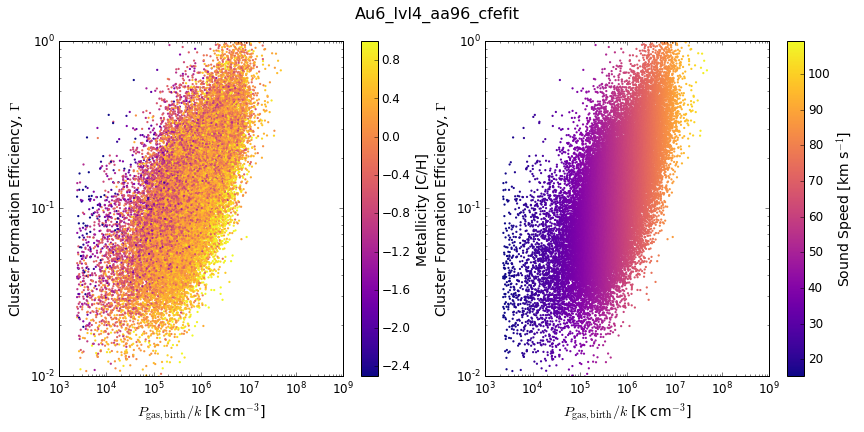

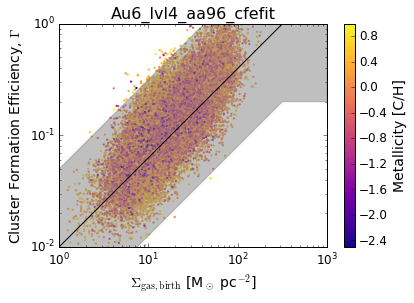

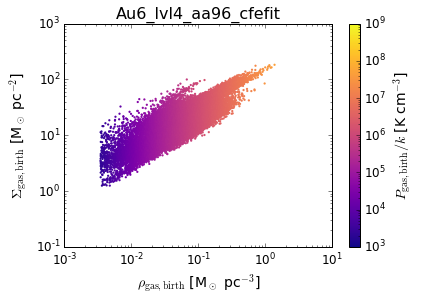

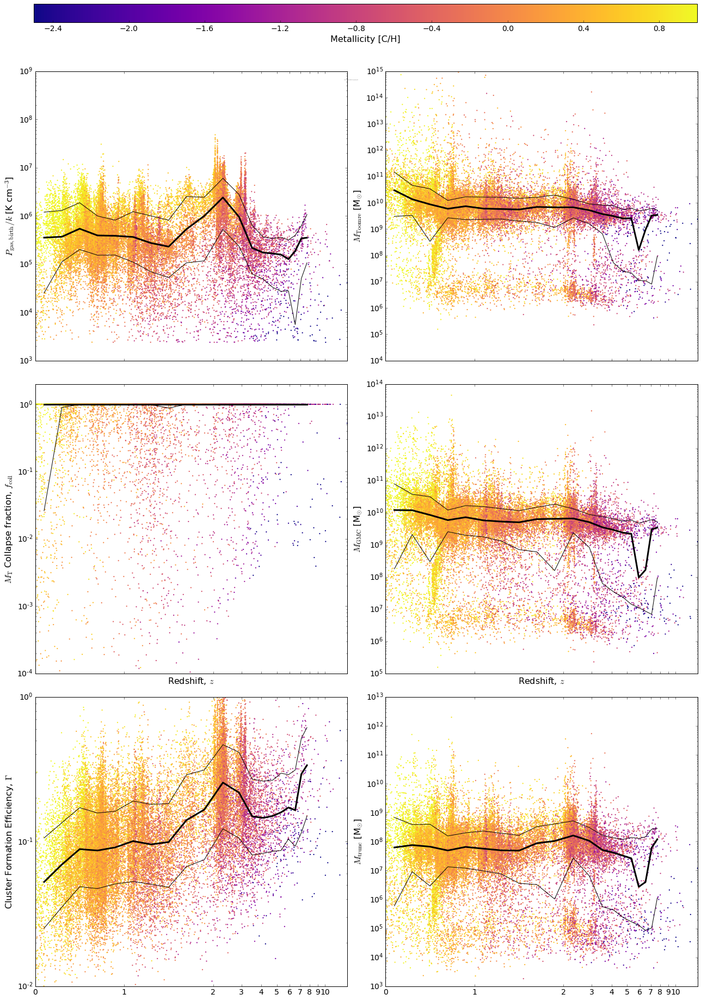

galrad= 0.02128308862447739
Found 1280999 stars.
Maximum number of formed clusters per star particle:  6


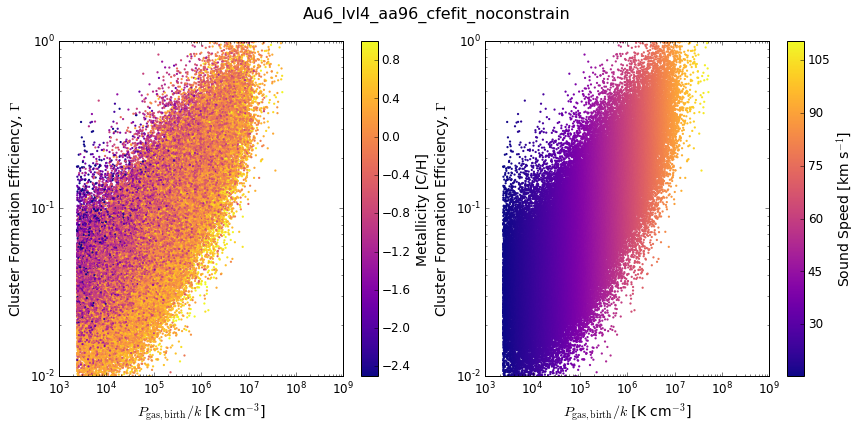

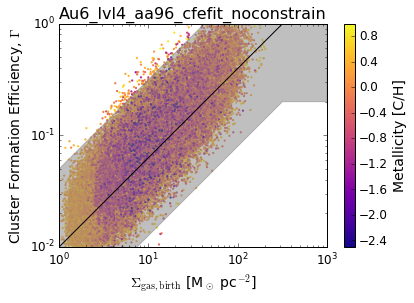

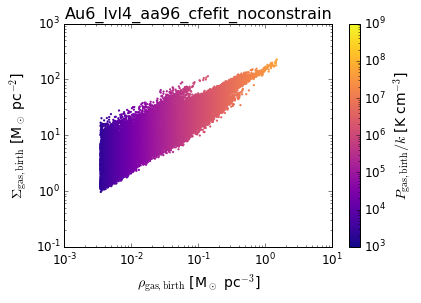

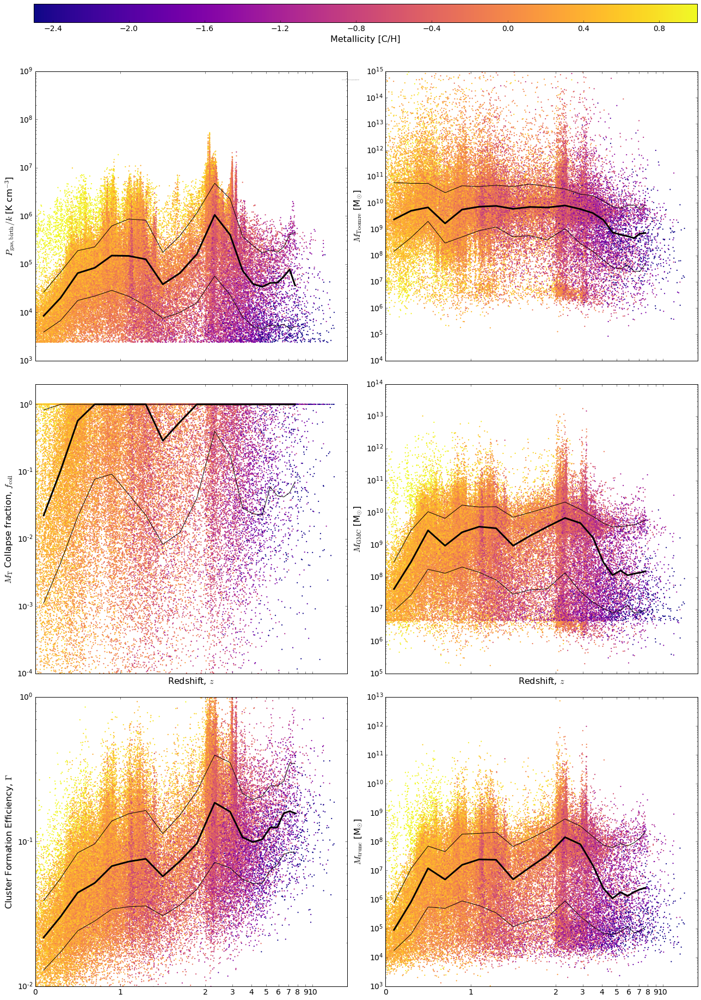

galrad= 0.019681689143180848
Found 70243 stars.
Maximum number of formed clusters per star particle:  14


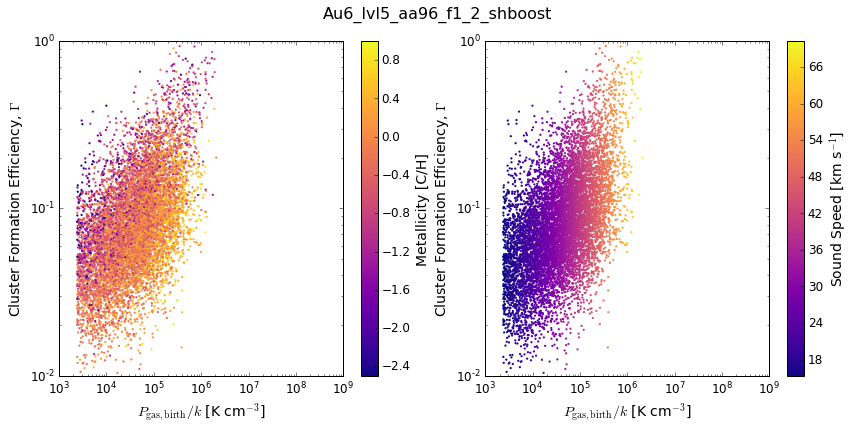

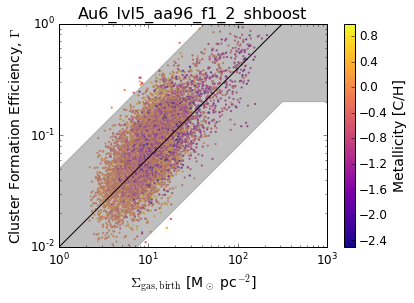

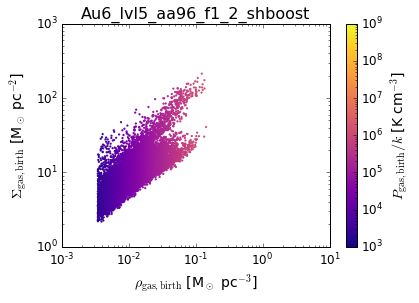

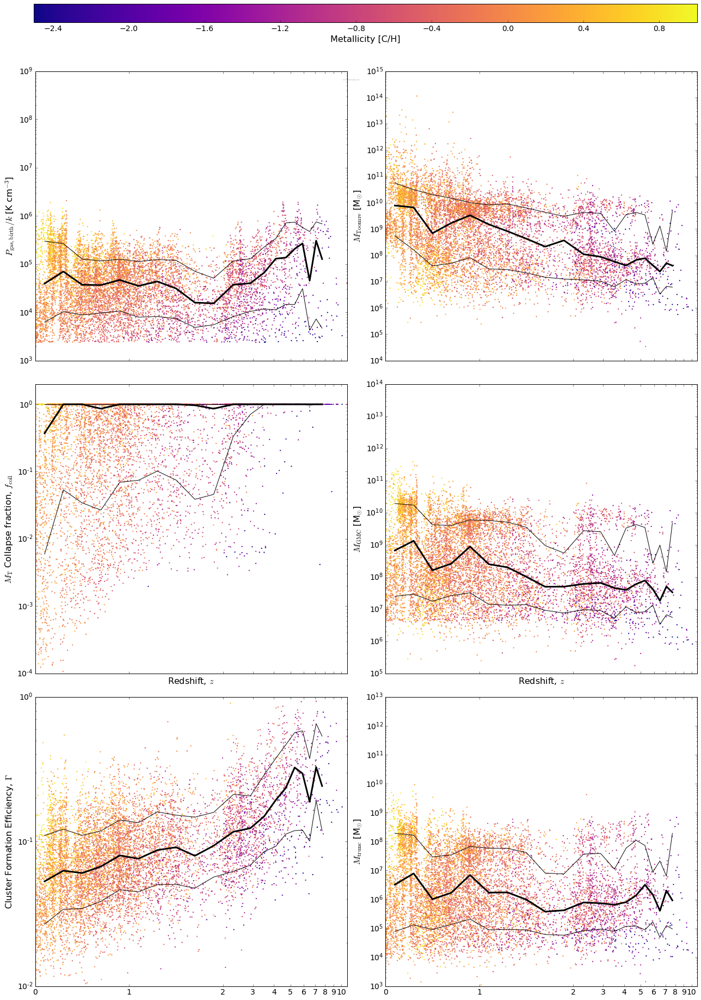

galrad= 0.021427297592163087
Found 1410432 stars.
Maximum number of formed clusters per star particle:  6


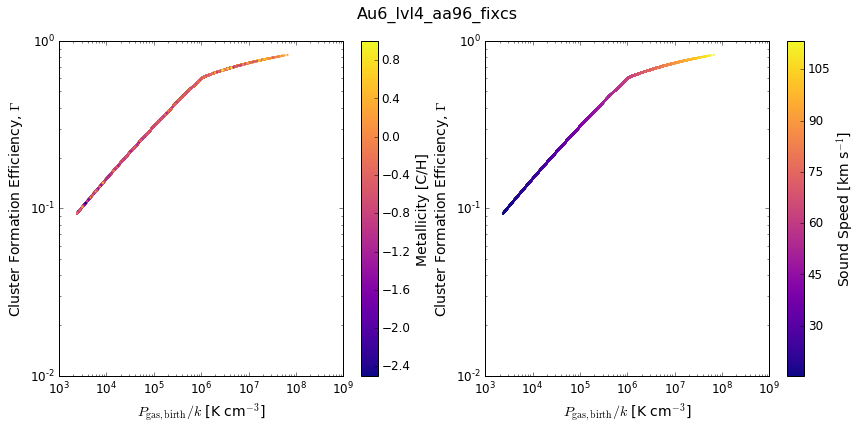

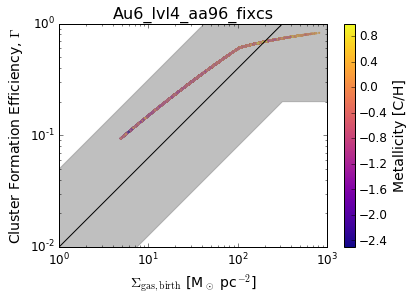

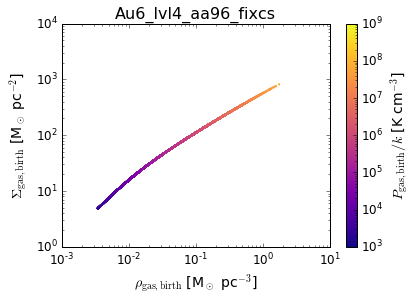

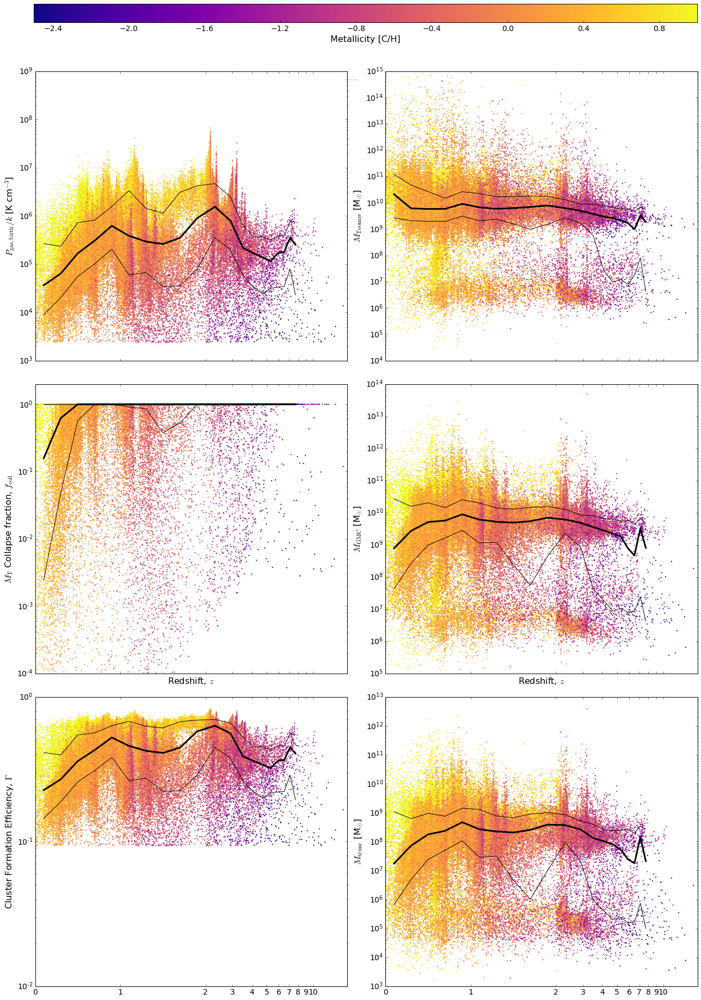

galrad= 0.019681689143180848
Found 70243 stars.
Maximum number of formed clusters per star particle:  14


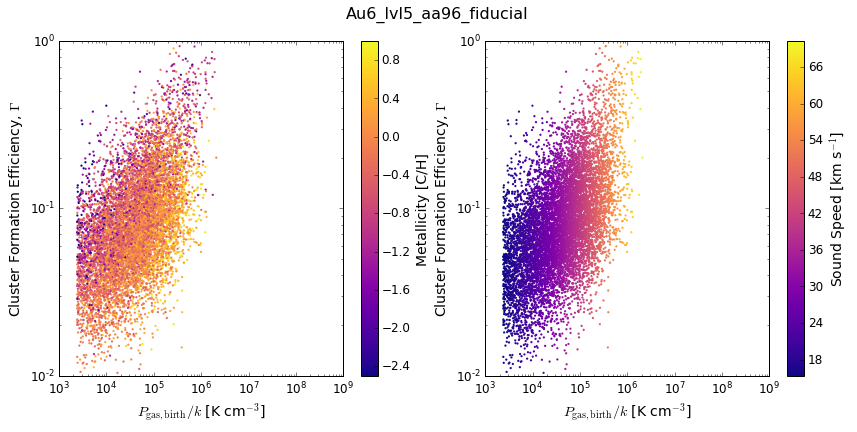

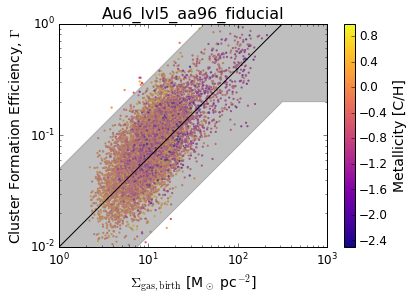

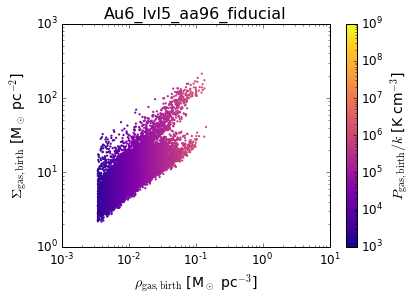

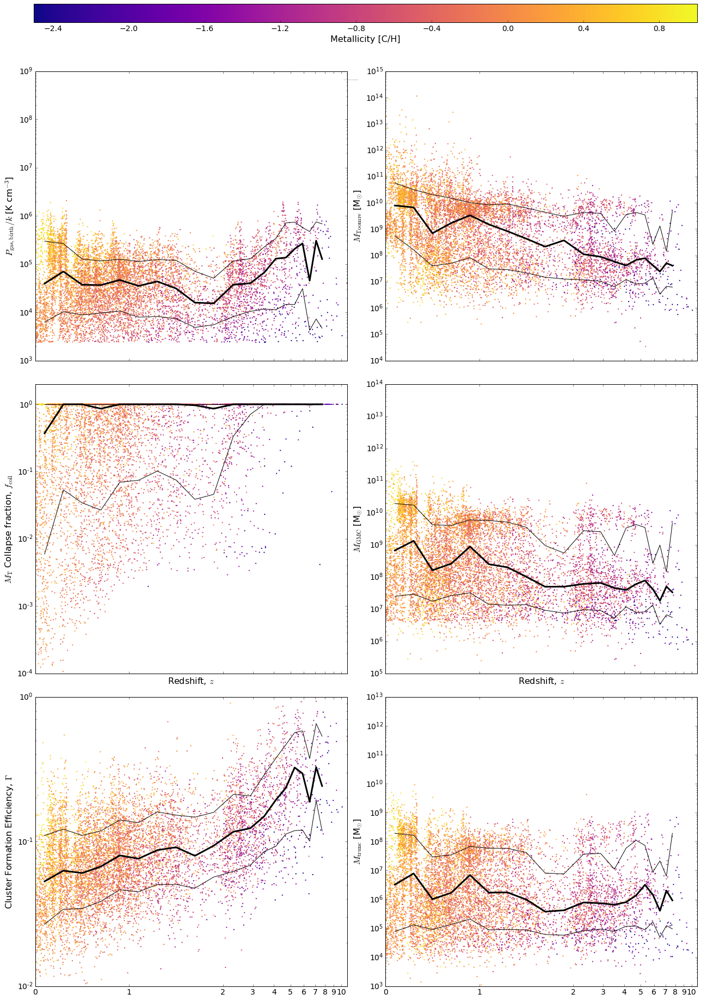

galrad= 0.02139813154935837
Found 1434190 stars.
Maximum number of formed clusters per star particle:  6


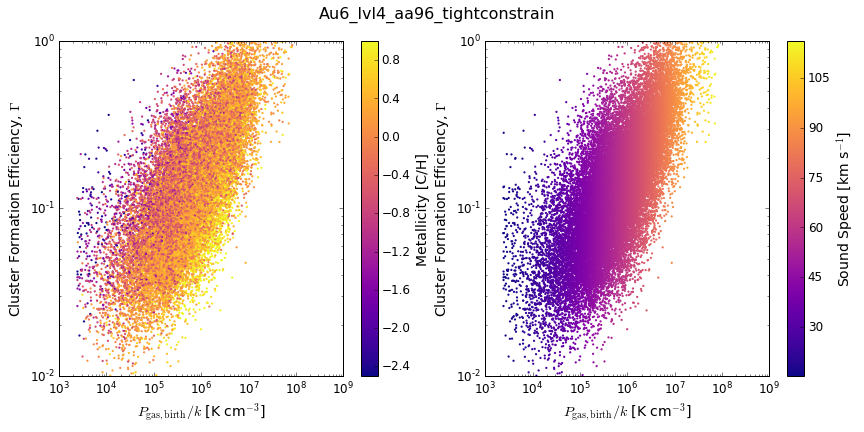

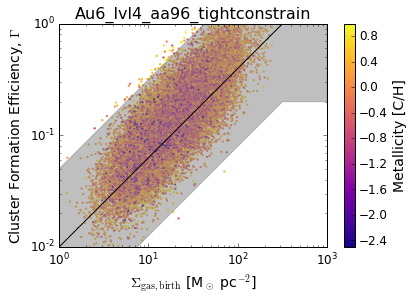

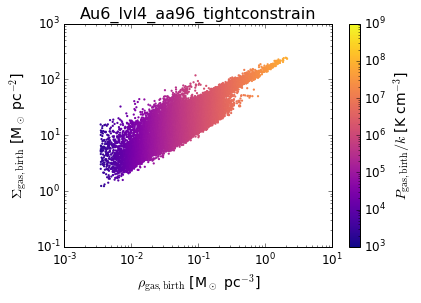

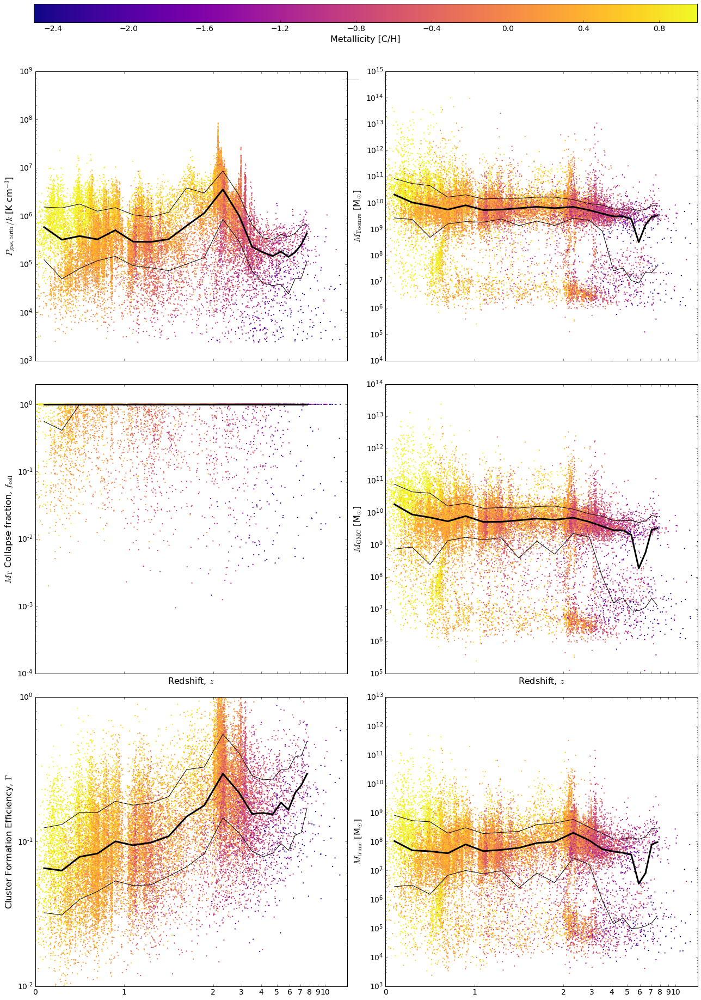

In [4]:
for sim in simulation_list:
    sf = load_subfind(127, dir=sim+'/output/')
    s = gadget_readsnap(127, snappath=sim+'/output/', subfind=sf, applytransformationfacs=True, hdf5=True, loadonlyhalo=0, loadonlytype=[4])

    s.calc_sf_indizes(sf)
    rot_matrix = s.select_halo(sf)

    s.parameters['UnitTime_in_s'] = s.parameters['UnitLength_in_cm']/s.parameters['UnitVelocity_in_cm_per_s']
    s.data['pos'] *= 1e3 # in kpc
    s.data['mass'] *= 1e10 # change mass to solar masses
    s.data['mclt'] *= 1e10
    s.data['imcl'] *= 1e10
    s.data['mtre'] *= 1e10
    s.data['mtrc'] *= 1e10
    s.data['bprs'] *= s.parameters['UnitMass_in_g'] / s.parameters['UnitLength_in_cm'] / (s.parameters['UnitTime_in_s']**2)
    s.data['bsig'] *= s.parameters['UnitMass_in_g'] / (s.parameters['UnitLength_in_cm']**2)
    s.data['bdens'] *= s.parameters['UnitMass_in_g'] / (s.parameters['UnitLength_in_cm']**3)
    s.data['bcs'] = np.sqrt(5./3. * s.data['bprs'] / s.data['bdens'])

    element = {'H':0, 'He':1, 'C':2, 'N':3, 'O':4, 'Ne':5, 'Mg':6, 'Si':7, 'Fe':8}
    elementnum = {'H':1, 'He':4, 'C':12, 'N':14, 'O':16, 'Ne':20, 'Mg':24, 'Si':28, 'Fe':56}
    #from Asplund et al. (2009) Table 5
    SUNABUNDANCES = {'H':12.0, 'He':10.98, 'C':8.47, 'N':7.87, 'O':8.73, 'Ne':7.97, 'Mg':7.64, 'Si':7.55, 'Fe':7.54}
    for iel,val in enumerate(element):
        s.data[val+'/H'] = np.log10( s.data['gmet'][:, element[val]] / s.data['gmet'][:, element['H']] / elementnum[val] )
        s.data[val+'/H'] -= (SUNABUNDANCES[val] - SUNABUNDANCES['H'])

    s.data['r'] = np.sqrt(np.sum((s.data['pos'])**2, axis=1))

    mask_clusters_initial = (s.data['incl'] > 0 )* (s.data['r']<=120)
    clusters_formtime = s.data['age'][mask_clusters_initial]
    clusters_age = s.cosmology_get_lookback_time_from_a(clusters_formtime, is_flat=True)
    stars_age = s.cosmology_get_lookback_time_from_a(s.data['age'], is_flat=True)

    redshift_bins = np.concatenate([np.linspace(0,2,11),np.linspace(2, 8, 11)[1:]])

    print('Maximum number of formed clusters per star particle: ', s.data['incl'].max())

    fig, ax = plt.subplots(1,2, figsize=(14,6))
    scatter = ax[0].scatter(s.data['bprs'][mask_clusters_initial]/k, s.data['lcfe'][mask_clusters_initial], c=s.data['C/H'][mask_clusters_initial],
                      edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    colorbar = fig.colorbar(scatter, ax=ax[0])
    colorbar.set_label('Metallicity [C/H]', fontsize=14)
    colorbar.ax.tick_params(labelsize=12)
    ax[0].set_xscale('log')
    ax[0].set_xlim(1e3,1e9)
    ax[0].set_yscale('log')
    ax[0].set_ylim(1e-2, 1e0)
    ax[0].tick_params(axis='both', which='major', labelsize=12)
    ax[0].set_xlabel(r'$P_{\rm{gas, birth}}/k$ [K cm$^{-3}$]', fontsize=14)
    ax[0].set_ylabel('Cluster Formation Efficiency, $\Gamma$', fontsize=14)
    scatter = ax[1].scatter(s.data['bprs'][mask_clusters_initial]/k, s.data['lcfe'][mask_clusters_initial], c=s.data['bcs'][mask_clusters_initial]/1e5,
                      edgecolors='none', cmap=cm.plasma, s=5)
    colorbar = fig.colorbar(scatter, ax=ax[1])
    colorbar.set_label('Sound Speed [km s$^{-1}$]', fontsize=14)
    colorbar.ax.tick_params(labelsize=12)
    ax[1].set_xscale('log')
    ax[1].set_xlim(1e3,1e9)
    ax[1].set_yscale('log')
    ax[1].set_ylim(1e-2, 1e0)
    ax[1].tick_params(axis='both', which='major', labelsize=12)
    ax[1].set_xlabel(r'$P_{\rm{gas, birth}}/k$ [K cm$^{-3}$]', fontsize=14)
    ax[1].set_ylabel('Cluster Formation Efficiency, $\Gamma$', fontsize=14)
    fig.suptitle(sim, fontsize=16)
    plt.show()

    def cfe(surfdens):
        cfe = 0.063 * (surfdens/10.)**0.8
        mask = cfe > 1.
        cfe[mask] = 1.
        return cfe
    
    fig, ax = plt.subplots(1,1)
    scatter = ax.scatter(s.data['bsig'][mask_clusters_initial] * parsec**2/solar_mass, s.data['lcfe'][mask_clusters_initial], c=s.data['C/H'][mask_clusters_initial],
                      edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    colorbar = fig.colorbar(scatter)
    surfdens = np.logspace(0,np.log10(1e3),10000)
    ax.loglog(surfdens, cfe(surfdens),c='k', label='CFE fit, Grudic+2022')
    ax.fill_between(surfdens, cfe(surfdens)*5, cfe(surfdens)/5, alpha=.5, color='grey',label=r'CFE fit $\pm$ 0.5 dex')

    colorbar.set_label('Metallicity [C/H]', fontsize=14)
    colorbar.ax.tick_params(labelsize=12)
    ax.set_xscale('log')
    ax.set_xlim(1e0,1e3)
    ax.set_yscale('log')
    ax.set_ylim(1e-2, 1e0)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel(r'$\Sigma_{\rm{gas, birth}}$ [M$_\odot$ pc$^{-2}$]', fontsize=14)
    ax.set_ylabel('Cluster Formation Efficiency, $\Gamma$', fontsize=14)
    ax.set_title(sim, fontsize=16)
    plt.show()

    fig, ax = plt.subplots(1,1)
    scatter = ax.scatter(s.data['bdens'][mask_clusters_initial]* parsec**3/solar_mass, s.data['bsig'][mask_clusters_initial]* parsec**2/solar_mass,
                         c=s.data['bprs'][mask_clusters_initial]/k, edgecolors='none', norm=colors.LogNorm(vmin=1e3, vmax=1e9), cmap=cm.plasma, s=5)
    colorbar = fig.colorbar(scatter)
    colorbar.set_label(r'$P_{\rm{gas, birth}}/k$ [K cm$^{-3}$]', fontsize=14)
    colorbar.ax.tick_params(labelsize=12)
    ax.set_xscale('log')
    ax.set_xlim(1e-3,1e1)
    ax.set_yscale('log')
    # ax.set_ylim(1e-2, 1e0)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.set_xlabel(r'$\rho_{\rm{gas, birth}}$ [M$_\odot$ pc$^{-3}$]', fontsize=14)
    ax.set_ylabel(r'$\Sigma_{\rm{gas, birth}}$ [M$_\odot$ pc$^{-2}$]', fontsize=14)
    ax.set_title(sim, fontsize=16)
    plt.show()

    fig, ax = plt.subplots(3, 2, figsize=(18,24), sharex=True)
    data = s.data['bprs'][mask_clusters_initial]/k
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    ax[0,0].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[0,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[0,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[0,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[0,0].set_ylim(1e3,1e9)
    ax[0,0].set_yscale('log')
    ax[0,0].set_ylabel(r'$P_{\rm{gas, birth}}/k$ [K cm$^{-3}$]', fontsize=16)
    ax[0,0].tick_params(axis='both', which='major', labelsize=14)

    data = s.data['mtre'][mask_clusters_initial]
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    ax[0,1].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[0,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[0,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[0,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[0,1].set_ylim(1e4,1e15)
    ax[0,1].set_yscale('log')
    ax[0,1].set_ylabel(r'$M_{\rm{Toomre}}$ [M$_{\odot}$]', fontsize=16)
    ax[0,1].tick_params(axis='both', which='major', labelsize=14)

    data = s.data['mtrc'][mask_clusters_initial]/(0.1 * s.data['lcfe'][mask_clusters_initial] * s.data['mtre'][mask_clusters_initial])
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    ax[1,0].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[1,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[1,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[1,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[1,0].set_ylim(1e-4, 2e0)
    ax[1,0].set_yscale('log')
    ax[1,0].set_ylabel(r'$M_{\rm{T}}$ Collapse fraction, $f_{\rm{coll}}$', fontsize=16)
    ax[1,0].tick_params(axis='both', which='major', labelsize=14)

    data = s.data['mtrc'][mask_clusters_initial]/(0.1 * s.data['lcfe'][mask_clusters_initial])
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    ax[1,1].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[1,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[1,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[1,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[1,1].set_ylim(1e5,1e14)
    ax[1,1].set_yscale('log')
    ax[1,1].set_ylabel(r'$M_{\rm{GMC}}$ [M$_{\odot}$]', fontsize=16)
    ax[1,1].tick_params(axis='both', which='major', labelsize=14)

    data = s.data['lcfe'][mask_clusters_initial]
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    ax[2,0].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[2,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[2,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[2,0].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[2,0].set_ylim(1e-2,1e0)
    ax[2,0].set_yscale('log')
    ax[2,0].set_ylabel('Cluster Formation Efficiency, $\Gamma$', fontsize=16)
    ax[2,0].tick_params(axis='both', which='major', labelsize=14)

    data = s.data['mtrc'][mask_clusters_initial]
    data_median = []
    data_up = []
    data_dn = []
    for ibin in range(len(redshift_bins)-1):
        mask = (1./clusters_formtime - 1. > redshift_bins[ibin]) * (1./clusters_formtime - 1. < redshift_bins[ibin+1])
        data_median.append(np.median(data[mask]))
        data_up.append(np.quantile(data[mask], 0.84))
        data_dn.append(np.quantile(data[mask], 0.16))
    cb = ax[2,1].scatter(1./clusters_formtime - 1., data,
                c=s.data['C/H'][mask_clusters_initial], edgecolors='none', vmin=-2.5, vmax=1., cmap=cm.plasma, s=5)
    ax[2,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_median), c='k', lw=3)
    ax[2,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_up), c='k', lw=1)
    ax[2,1].plot((redshift_bins[1:] + redshift_bins[:-1])/2, np.array(data_dn), c='k', lw=1)
    ax[2,1].set_ylim(1e3,1e13)
    ax[2,1].set_yscale('log')
    ax[2,1].set_ylabel(r'$M_{\rm{trunc}}$ [M$_{\odot}$]', fontsize=16)
    ax[2,1].tick_params(axis='both', which='major', labelsize=14)
    
    for axi in ax[1,:]:
        axi.set_xlim(0,(1./clusters_formtime - 1.).max())
        axi.set_xscale('symlog')
        axi.xaxis.set_major_locator(ticker.FixedLocator([0,1,2,3,4,5,6,7,8,9,10]))
        axi.xaxis.set_major_formatter(ticker.ScalarFormatter())
        axi.set_xlabel('Redshift, $z$', fontsize=16)

    plt.tight_layout()

    cbar_ax = fig.add_axes([.051, 1.04, 0.94, 0.02])
    cbar = fig.colorbar(cb, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Metallicity [C/H]', fontsize=16)
    cbar.ax.tick_params(labelsize=14)

    fig.suptitle('Cluster Formation Properties, '+sim, fontsize=1)

    plt.show()

/storage/home/can35/can35007/pylib/gadget_subfind.py:447: H5pyDeprecationWarning: Using astype() as a context manager is deprecated. Slice the returned object instead, like: ds.astype(np.int32)[:10]
  with dset.astype('int64'):
/storage/home/can35/can35007/pylib/gadget_snap.py:730: H5pyDeprecationWarning: Using astype() as a context manager is deprecated. Slice the returned object instead, like: ds.astype(np.int32)[:10]
  with dset.astype('uint64'):
/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: divide by zero encountered in log10
/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in log10
/storage/home/can35/can35007/pylib/cosmological_factors.py:100: RuntimeWarning: invalid value encountered in sqrt
  var2 = np.sqrt(self.OmegaLambda / self.OmegaMatter * a**3.0)


galrad= 0.019405122101306918
Found 73883 stars.
Maximum number of formed clusters per star particle:  14
galrad= 0.019405122101306918
Found 73883 stars.
Maximum number of formed clusters per star particle:  14
galrad= 0.021321217715740207
Found 1562819 stars.
Maximum number of formed clusters per star particle:  6
galrad= 0.02128308862447739
Found 1280999 stars.
Maximum number of formed clusters per star particle:  6
galrad= 0.019681689143180848
Found 70243 stars.
Maximum number of formed clusters per star particle:  14
galrad= 0.021427297592163087
Found 1410432 stars.
Maximum number of formed clusters per star particle:  6
galrad= 0.019681689143180848
Found 70243 stars.
Maximum number of formed clusters per star particle:  14
galrad= 0.02139813154935837
Found 1434190 stars.
Maximum number of formed clusters per star particle:  6


/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/apps/PYTHON/3.7.4-Anaconda3-2019.10/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


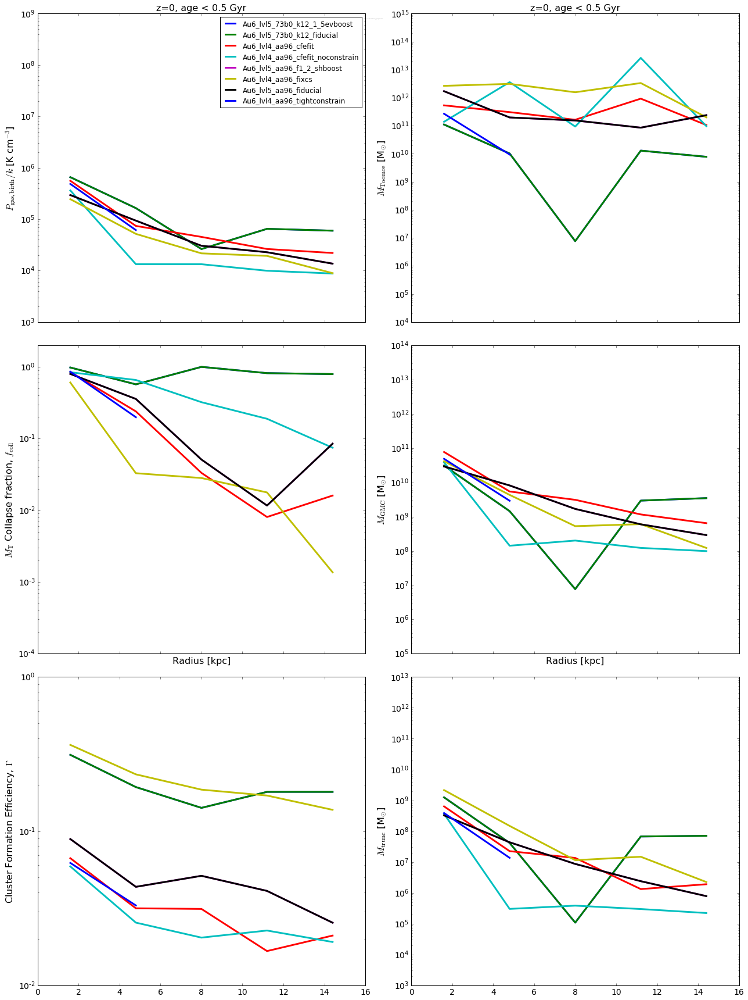

In [6]:
p_mean = []
mtre_median = []
fcoll_mean = []
mgmc_mean = []
mtrc_mean = []
lcfe_mean = []
for sim in simulation_list:
    sf = load_subfind(127, dir=sim+'/output/')
    s = gadget_readsnap(127, snappath=sim+'/output/', subfind=sf, applytransformationfacs=True, hdf5=True, loadonlyhalo=0, loadonlytype=[4])

    s.calc_sf_indizes(sf)
    rot_matrix = s.select_halo(sf)

    s.parameters['UnitTime_in_s'] = s.parameters['UnitLength_in_cm']/s.parameters['UnitVelocity_in_cm_per_s']
    s.data['pos'] *= 1e3 # in kpc
    s.data['mass'] *= 1e10 # change mass to solar masses
    s.data['mclt'] *= 1e10
    s.data['imcl'] *= 1e10
    s.data['mtre'] *= 1e10
    s.data['mtrc'] *= 1e10
    s.data['bprs'] *= s.parameters['UnitMass_in_g'] / s.parameters['UnitLength_in_cm'] / (s.parameters['UnitTime_in_s']**2)
    s.data['bsig'] *= s.parameters['UnitMass_in_g'] / (s.parameters['UnitLength_in_cm']**2)
    s.data['bdens'] *= s.parameters['UnitMass_in_g'] / (s.parameters['UnitLength_in_cm']**3)
    s.data['bcs'] = np.sqrt(5./3. * s.data['bprs'] / s.data['bdens'])

    element = {'H':0, 'He':1, 'C':2, 'N':3, 'O':4, 'Ne':5, 'Mg':6, 'Si':7, 'Fe':8}
    elementnum = {'H':1, 'He':4, 'C':12, 'N':14, 'O':16, 'Ne':20, 'Mg':24, 'Si':28, 'Fe':56}
    #from Asplund et al. (2009) Table 5
    SUNABUNDANCES = {'H':12.0, 'He':10.98, 'C':8.47, 'N':7.87, 'O':8.73, 'Ne':7.97, 'Mg':7.64, 'Si':7.55, 'Fe':7.54}
    for iel,val in enumerate(element):
        s.data[val+'/H'] = np.log10( s.data['gmet'][:, element[val]] / s.data['gmet'][:, element['H']] / elementnum[val] )
        s.data[val+'/H'] -= (SUNABUNDANCES[val] - SUNABUNDANCES['H'])

    s.data['r'] = np.sqrt(np.sum((s.data['pos'])**2, axis=1))

    mask_clusters_initial = (s.data['incl'] > 0 )* (s.data['r']<=120)
    clusters_formtime = s.data['age'][mask_clusters_initial]
    clusters_age = s.cosmology_get_lookback_time_from_a(clusters_formtime, is_flat=True)
    stars_age = s.cosmology_get_lookback_time_from_a(s.data['age'], is_flat=True)

    radius_bins = np.linspace(0, 16, 6)

    print('Maximum number of formed clusters per star particle: ', s.data['incl'].max()) 
    
    mask_age = stars_age[mask_clusters_initial] < 1.
    data = s.data['bprs'][mask_clusters_initial][mask_age]/k
    data_mean = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_mean.append(np.mean(data[mask]))
    p_mean.append(data_mean)
    data = s.data['mtre'][mask_clusters_initial][mask_age]
    data_median = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_median.append(np.mean(data[mask]))
    mtre_median.append(data_median)
    data = s.data['mtrc'][mask_clusters_initial][mask_age]/(0.1 * s.data['lcfe'][mask_clusters_initial][mask_age] * s.data['mtre'][mask_clusters_initial][mask_age])
    data_mean = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_mean.append(np.mean(data[mask]))
    fcoll_mean.append(data_mean)
    data = s.data['mtrc'][mask_clusters_initial][mask_age]/(0.1 * s.data['lcfe'][mask_clusters_initial][mask_age])
    data_mean = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_mean.append(np.mean(data[mask]))
    mgmc_mean.append(data_mean)
    data = s.data['lcfe'][mask_clusters_initial][mask_age]
    data_mean = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_mean.append(np.mean(data[mask]))
    lcfe_mean.append(data_mean)
    data = s.data['mtrc'][mask_clusters_initial][mask_age]
    data_mean = []
    for ibin in range(len(radius_bins)-1):
        mask = (s.data['r'][mask_clusters_initial][mask_age] > radius_bins[ibin]) * (s.data['r'][mask_clusters_initial][mask_age]  < radius_bins[ibin+1])
        data_mean.append(np.mean(data[mask]))
    mtrc_mean.append(data_mean)

fig, ax = plt.subplots(3, 2, figsize=(18,24), sharex=True)
for i,line in enumerate(p_mean):
    ax[0,0].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3, label=simulation_list[i])
ax[0,0].set_ylim(1e3,1e9)
ax[0,0].set_yscale('log')
ax[0,0].set_ylabel(r'$P_{\rm{gas, birth}}/k$ [K cm$^{-3}$]', fontsize=16)
ax[0,0].tick_params(axis='both', which='major', labelsize=14)
ax[0,0].legend()

for line in mtre_median:
    ax[0,1].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3)
ax[0,1].set_ylim(1e4,1e15)
ax[0,1].set_yscale('log')
ax[0,1].set_ylabel(r'$M_{\rm{Toomre}}$ [M$_{\odot}$]', fontsize=16)
ax[0,1].tick_params(axis='both', which='major', labelsize=14)

for line in fcoll_mean:
    ax[1,0].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3)
ax[1,0].set_ylim(1e-4, 2e0)
ax[1,0].set_yscale('log')
ax[1,0].set_ylabel(r'$M_{\rm{T}}$ Collapse fraction, $f_{\rm{coll}}$', fontsize=16)
ax[1,0].tick_params(axis='both', which='major', labelsize=14)

for line in mgmc_mean:
    ax[1,1].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3)
ax[1,1].set_ylim(1e5,1e14)
ax[1,1].set_yscale('log')
ax[1,1].set_ylabel(r'$M_{\rm{GMC}}$ [M$_{\odot}$]', fontsize=16)
ax[1,1].tick_params(axis='both', which='major', labelsize=14)

for line in lcfe_mean:
    ax[2,0].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3)
ax[2,0].set_ylim(1e-2,1e0)
ax[2,0].set_yscale('log')
ax[2,0].set_ylabel('Cluster Formation Efficiency, $\Gamma$', fontsize=16)
ax[2,0].tick_params(axis='both', which='major', labelsize=14)

for line in mtrc_mean:
    ax[2,1].plot((radius_bins[1:] + radius_bins[:-1])/2, np.array(line), lw=3)
ax[2,1].set_ylim(1e3,1e13)
ax[2,1].set_yscale('log')
ax[2,1].set_ylabel(r'$M_{\rm{trunc}}$ [M$_{\odot}$]', fontsize=16)
ax[2,1].tick_params(axis='both', which='major', labelsize=14)

for axi in ax[1,:]:
    axi.set_xlim(0,16)
    axi.set_xlabel('Radius [kpc]', fontsize=16)
for axi in ax[0,:]:
    axi.set_title('z=0, age < 0.5 Gyr', fontsize=16)

plt.tight_layout()

fig.suptitle('Cluster Formation Properties, '+sim, fontsize=1)
plt.show()